In [1]:
import sys
import stlearn as st
st.settings.set_figure_params(dpi=300)
from pathlib import Path
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
import sys
# file = Path("../stimage").resolve()
# parent= file.parent
# sys.path.append(str(parent))
from PIL import Image
# from stimage._utils import gene_plot, Read10X, ReadOldST, tiling, ensembl_to_id
# from stimage._model import CNN_NB_multiple_genes, negative_binomial_layer, negative_binomial_loss
# from stimage._data_generator import DataGenerator
# import tensorflow as tf
import seaborn as sns
sns.set_style("white")
import matplotlib.pyplot as plt
from scipy import stats
import numpy as np
import geopandas as gpd
from sklearn.neighbors import KDTree
from anndata import read_h5ad
# from tensorflow.keras import backend as K
import scanpy as sc
import pickle

/tmp/ipykernel_151106/2508529726.py:22: UserWarning: Shapely 2.0 is installed, but because PyGEOS is also installed, GeoPandas will still use PyGEOS by default for now. To force to use and test Shapely 2.0, you have to set the environment variable USE_PYGEOS=0. You can do this before starting the Python process, or in your code before importing geopandas:

import os
os.environ['USE_PYGEOS'] = '0'
import geopandas

In a future release, GeoPandas will switch to using Shapely by default. If you are using PyGEOS directly (calling PyGEOS functions on geometries from GeoPandas), this will then stop working and you are encouraged to migrate from PyGEOS to Shapely 2.0 (https://shapely.readthedocs.io/en/latest/migration_pygeos.html).
  import geopandas as gpd


In [2]:
import warnings
from typing import Optional, Union
# import cv2 as cv 
import scanpy
from anndata import AnnData
from matplotlib import pyplot as plt


# from .utils import get_img_from_fig, checkType

from PIL import Image

# from .utils import get_img_from_fig, checkType


def gene_plot(
        adata: AnnData,
        method: str = "CumSum",
        genes: Optional[Union[str, list]] = None,
        threshold: float = None,
        library_id: str = None,
        data_alpha: float = 1.0,
        tissue_alpha: float = 1.0,
        fig = None,
        ax = None,
        vmin: float = None,
        vmax: float = None,
        cmap: str = "Spectral_r",
        spot_size: Union[float, int] = 6.5,
        show_legend: bool = False,
        show_color_bar: bool = True,
        show_axis: bool = False,
        cropped: bool = True,
        image_scale: int= None,
        margin: int = 100,
        name: str = None,
        output: str = None,
        copy: bool = False,
) -> Optional[AnnData]:
    """\
    Gene expression plot for sptial transcriptomics data.
    Parameters
    ----------
    adata
        Annotated data matrix.
    library_id
        Library id stored in AnnData.
    method
        Use method to count. We prorive: NaiveMean, NaiveSum, CumSum.
    genes
        Choose a gene or a list of genes.
    threshold
        Threshold to filter genes
    data_alpha
        Opacity of the spot.
    tissue_alpha
        Opacity of the tissue.
    cmap
        Color map to use.
    spot_size
        Size of the spot.
    show_color_bar
        Show color bar or not.
    show_axis
        Show axis or not.
    show_legend
        Show legend or not.
    show_trajectory
        Show the spatial trajectory or not. It requires stlearn.spatial.trajectory.pseudotimespace.
    show_subcluster
        Show subcluster or not. It requires stlearn.spatial.trajectory.global_level.
    name
        Name of the output figure file.
    output
        Save the figure as file or not.
    copy
        Return a copy instead of writing to adata.
    Returns
    -------
    Nothing
    """

    # plt.rcParams['figure.dpi'] = dpi

    if type(genes) == str:
        genes = [genes]
    colors = _gene_plot(adata, method, genes)

    if threshold is not None:
        colors = colors[colors > threshold]

    index_filter = colors.index

    filter_obs = adata.obs.loc[index_filter]

    scale_factor = 1
    if image_scale:
        scale_factor = 1 / image_scale

    imagecol = filter_obs["imagecol"] * scale_factor
    imagerow = filter_obs["imagerow"] * scale_factor

    # Option for turning off showing figure
    plt.ioff()

    # Initialize matplotlib
#     fig, a = plt.subplots()
    if ax:
        
        fig = fig
        a = ax
    else:
        fig, a = plt.subplots()
        
    if vmin:
        vmin = vmin
    else:
        vmin = min(colors)
    if vmax:
        vmax = vmax
    else:
        vmax = max(colors)
    # Plot scatter plot based on pixel of spots
    plot = a.scatter(imagecol, imagerow, edgecolor="none", alpha=data_alpha, s=spot_size, marker="o",
                     vmin=vmin, vmax=vmax, cmap=plt.get_cmap(cmap), c=colors)

    if show_color_bar:
        cb = plt.colorbar(plot, cax=fig.add_axes(
            [0.9, 0.3, 0.03, 0.38]), cmap=cmap)
        cb.outline.set_visible(False)

    if not show_axis:
        a.axis('off')

    if library_id is None:
        library_id = list(adata.uns["spatial"].keys())[0]

    image = adata.uns["spatial"][library_id]["images"][adata.uns["spatial"][library_id]["use_quality"]]
    scale_size = (image.shape[1]* scale_factor, image.shape[0]* scale_factor)
    image_pil = Image.fromarray(image)
    image_pil.thumbnail(scale_size, Image.ANTIALIAS)
    image = np.array(image_pil)
    # Overlay the tissue image
    a.imshow(image, alpha=tissue_alpha, zorder=-1, )

    if cropped:
        imagecol = adata.obs["imagecol"] * scale_factor
        imagerow = adata.obs["imagerow"] * scale_factor

        a.set_xlim(imagecol.min() - margin,
                   imagecol.max() + margin)

        a.set_ylim(imagerow.min() - margin,
                   imagerow.max() + margin)

        a.set_ylim(a.get_ylim()[::-1])

    if name is None:
        name = method
    if output is not None:
        fig.savefig(output + "/" + name, dpi=plt.figure().dpi,
                    bbox_inches='tight', pad_inches=0)

#     plt.show()


def _gene_plot(adata, method, genes):
    # Gene plot option

    if len(genes) == 0:
        raise ValueError('Genes shoule be provided, please input genes')

    elif len(genes) == 1:

        if genes[0] not in adata.var.index:
            raise ValueError(
                genes[0] + ' is not exist in the data, please try another gene')

        colors = adata[:, genes].to_df().iloc[:, -1]

        return colors
    else:

        for gene in genes:
            if gene not in adata.var.index:
                genes.remove(gene)
                warnings.warn("We removed " + gene +
                              " because they not exist in the data")

            if len(genes) == 0:
                raise ValueError(
                    'All provided genes are not exist in the data')

        count_gene = adata[:, genes].to_df()

        if method is None:
            raise ValueError(
                'Please provide method to combine genes by NaiveMean/NaiveSum/CumSum')

        if method == "NaiveMean":
            present_genes = (count_gene > 0).sum(axis=1) / len(genes)

            count_gene = (count_gene.mean(axis=1)) * present_genes
        elif method == "NaiveSum":
            present_genes = (count_gene > 0).sum(axis=1) / len(genes)

            count_gene = (count_gene.sum(axis=1)) * present_genes

        elif method == "CumSum":
            count_gene = count_gene.cumsum(axis=1).iloc[:, -1]

        colors = count_gene

        return colors

In [3]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_style("white")
from matplotlib.patches import PathPatch

def adjust_box_widths(g, fac):
    """
    Adjust the widths of a seaborn-generated boxplot.
    """

    # iterating through Axes instances
    for ax in g.axes:

        # iterating through axes artists:
        for c in ax.get_children():

            # searching for PathPatches
            if isinstance(c, PathPatch):
                # getting current width of box:
                p = c.get_path()
                verts = p.vertices
                verts_sub = verts[:-1]
                xmin = np.min(verts_sub[:, 0])
                xmax = np.max(verts_sub[:, 0])
                xmid = 0.5*(xmin+xmax)
                xhalf = 0.5*(xmax - xmin)

                # setting new width of box
                xmin_new = xmid-fac*xhalf
                xmax_new = xmid+fac*xhalf
                verts_sub[verts_sub[:, 0] == xmin, 0] = xmin_new
                verts_sub[verts_sub[:, 0] == xmax, 0] = xmax_new

                # setting new width of median line
                for l in ax.lines:
                    if np.all(l.get_xdata() == [xmin, xmax]):
                        l.set_xdata([xmin_new, xmax_new])


class GridShader():
    def __init__(self, ax, first=True, **kwargs):
        self.spans = []
        self.sf = first
        self.ax = ax
        self.kw = kwargs
        self.ax.autoscale(False, axis="x")
        self.cid = self.ax.callbacks.connect('xlim_changed', self.shade)
        self.shade()
    def clear(self):
        for span in self.spans:
            try:
                span.remove()
            except:
                pass
    def shade(self, evt=None):
        self.clear()
        xticks = self.ax.get_xticks()
        xlim = self.ax.get_xlim()
        xticks = xticks[(xticks > xlim[0]) & (xticks < xlim[-1])]
        locs = np.concatenate(([[xlim[0]], xticks+0.5, [xlim[-1]]]))

        start = locs[1-int(self.sf)::2]
        end = locs[2-int(self.sf)::2]

        for s, e in zip(start, end):
            self.spans.append(self.ax.axvspan(s, e, zorder=0, **self.kw))


In [4]:
BASE_PATH = Path("/clusterdata/uqxtan9/Xiao/STimage/development/stimage_benchmarking_1000hvg_OOD")

In [5]:
df = pd.DataFrame()

In [6]:
for method in ["histogene", "stnet", "hist2ST", "stimage"]:
    for f in BASE_PATH.glob("./{}*.csv".format(method)):
        df_ = pd.read_csv(f, index_col=0)
        df = df.append(df_, ignore_index=True)

/tmp/ipykernel_151106/847364718.py:4: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df_, ignore_index=True)
/tmp/ipykernel_151106/847364718.py:4: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df_, ignore_index=True)
/tmp/ipykernel_151106/847364718.py:4: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df_, ignore_index=True)
/tmp/ipykernel_151106/847364718.py:4: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df_, ignore_index=True)


In [7]:
# df["Method"] = pd.Categorical(df["Method"], ordered=)

In [8]:
# df = df.sort_values(["Slide", "Pearson correlation"])

In [9]:
df["Metrix"] = "Pearson\ncorrelation"

In [10]:
df.columns = ['Gene', 'Score', 'Slide', 'Method', 'Metrix']

/tmp/ipykernel_151106/755545127.py:36: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if np.all(l.get_xdata() == [xmin, xmax]):


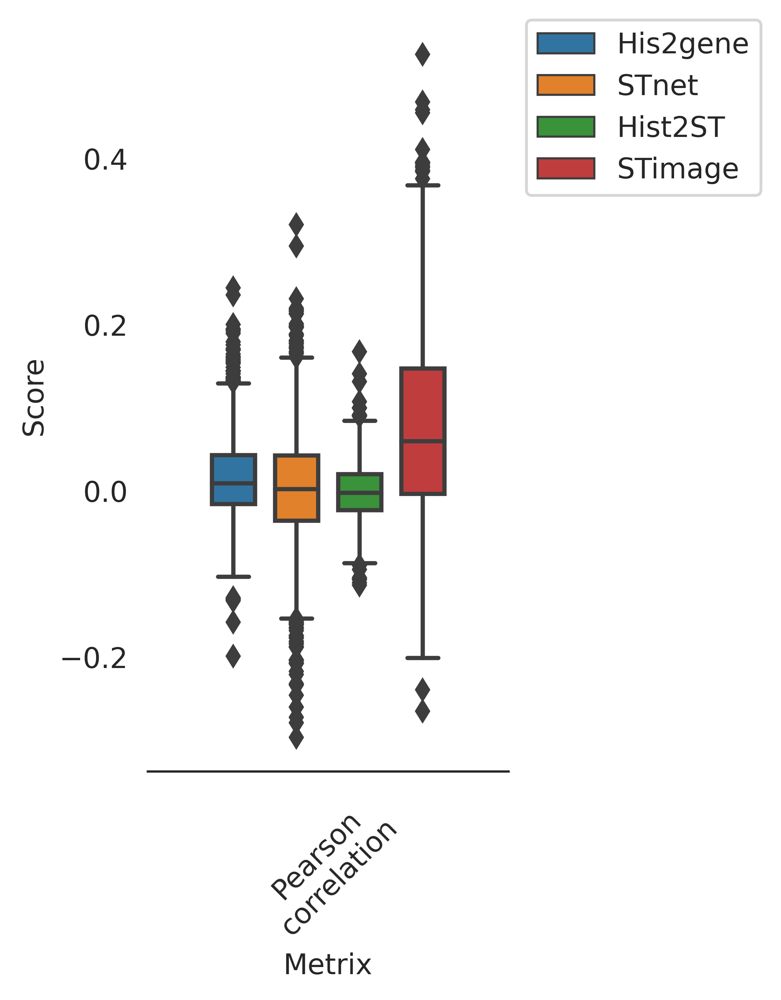

In [11]:
fig = plt.figure(figsize=(4, 5))
a = sns.boxplot(x="Metrix", y="Score", hue="Method",

               width=0.7,
               data=df)
a.set_xticklabels(a.get_xticklabels(), rotation=45)
sns.despine(left=True)
a.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
adjust_box_widths(fig, 0.7)
plt.autoscale()
gs = GridShader(a, facecolor="lightgrey", first=False, alpha=0.7)
plt.tight_layout()
# plt.savefig("./benchmarking_OOD_FFPE_1000hvg.png", dpi=300)
plt.show()

# spatial autocorrelation

In [12]:
import matplotlib.pyplot as plt
from libpysal.weights.contiguity import Queen
from libpysal import examples
import numpy as np
import pandas as pd
import geopandas as gpd
import os
import splot
from splot.esda import moran_scatterplot, lisa_cluster
from esda.moran import Moran, Moran_Local
from esda.moran import Moran_BV, Moran_Local_BV
from splot.esda import plot_moran_bv_simulation, plot_moran_bv, plot_local_autocorrelation

In [13]:
from anndata import AnnData
from typing import Iterable, Union, Optional
import pandas as pd
def spatial_autocorr(adata_true: AnnData,
                     adata_pred: AnnData,
                     model_name: str,
                     p: float = 0.05,
                     save_plots: str = None,
) -> Optional[AnnData]:
    
    assert len(adata_true.var_names) == len(adata_pred.var_names)
    
    gpd_name = "gpd_{}".format(model_name)
    library_id = list(adata_true.uns["spatial"].keys())[0]
#     tissue_image = adata_true.uns["spatial"][library_id]["images"]["fulres"]
    
    adata_true.obsm[gpd_name] = gpd.GeoDataFrame(adata_true.obs,
                                                 geometry=gpd.points_from_xy(
                                                          adata_true.obs.imagecol, 
                                                          adata_true.obs.imagerow))
    w = Queen.from_dataframe(adata_true.obsm[gpd_name])
    
    spatial_autocorr_label = []
    moran_i = []
    n_sigs = []
    for gene in adata_true.var_names:
        x = np.array(adata_true.to_df()[gene].values, dtype='float')
        y = np.array(adata_pred.to_df()[gene].values, dtype='float')
        
        adata_true.obsm[gpd_name]["gc_{}".format(gene)] = x
        adata_true.obsm[gpd_name]["pred_{}".format(gene)] = y
        
#         moran = Moran(x,w)
        moran_bv = Moran_BV(y, x, w)
#         moran_loc = Moran_Local(x, w)
        moran_loc_bv = Moran_Local_BV(y, x, w)
        
        labels, n_sig = hot_cold_label(moran_loc_bv, p)
        spatial_autocorr_label.append(labels)
        moran_i.append(moran_bv.I)
        n_sigs.append(n_sig)
        
#         if save_plots:
#             lisa_cluster(moran_loc_bv, adata_true.obsm[gpd_name], p=0.05, 
#                          figsize = (9,9), markersize=12,)# **{"alpha":1})
#             plt.imshow(tissue_image)
#             plt.savefig(save_plots / "lisa_cluster_{}".format(gene))
            
#         adata_true.obsm[gpd_name].drop(["gc_{}".format(gene),
#                                         "pred_{}".format(gene)], inplace=True, axis=1)
    
    adata_true.obsm["spatial_autocorr_{}".format(model_name)] = np.array(spatial_autocorr_label).transpose()
    adata_true.var["moran_i_{}".format(model_name)] = moran_i
    adata_true.var["n_sigs_{}".format(model_name)] = n_sigs
    
    return adata_true.copy()


def hot_cold_label(moran_loc, p):
    cluster = moran_hot_cold_spots(moran_loc, p)
    cluster_labels = ['ns', 'HH', 'LH', 'LL', 'HL']
    labels = [cluster_labels[i] for i in cluster]
    n_sig = labels.count('HH') + labels.count('LL')
    return labels, n_sig

In [14]:
from matplotlib import patches, colors
def lisa_cluster(moran_loc, gdf, p=0.05, ax=None,
                 legend=True, legend_kwds=None, **kwargs):
    """
    Create a LISA Cluster map
    Parameters
    ----------
    moran_loc : esda.moran.Moran_Local or Moran_Local_BV instance
        Values of Moran's Local Autocorrelation Statistic
    gdf : geopandas dataframe instance
        The Dataframe containing information to plot. Note that `gdf` will be
        modified, so calling functions should use a copy of the user
        provided `gdf`. (either using gdf.assign() or gdf.copy())
    p : float, optional
        The p-value threshold for significance. Points will
        be colored by significance.
    ax : matplotlib Axes instance, optional
        Axes in which to plot the figure in multiple Axes layout.
        Default = None
    legend : boolean, optional
        If True, legend for maps will be depicted. Default = True
    legend_kwds : dict, optional
        Dictionary to control legend formatting options. Example:
        ``legend_kwds={'loc': 'upper left', 'bbox_to_anchor': (0.92, 1.05)}``
        Default = None
    **kwargs : keyword arguments, optional
        Keywords designing and passed to geopandas.GeoDataFrame.plot().
    Returns
    -------
    fig : matplotlip Figure instance
        Figure of LISA cluster map
    ax : matplotlib Axes instance
        Axes in which the figure is plotted
    Examples
    --------
    Imports
    
    >>> import matplotlib.pyplot as plt
    >>> from libpysal.weights.contiguity import Queen
    >>> from libpysal import examples
    >>> import geopandas as gpd
    >>> from esda.moran import Moran_Local
    >>> from splot.esda import lisa_cluster
    Data preparation and statistical analysis
    
    >>> guerry = examples.load_example('Guerry')
    >>> link_to_data = guerry.get_path('guerry.shp')
    >>> gdf = gpd.read_file(link_to_data)
    >>> y = gdf['Donatns'].values
    >>> w = Queen.from_dataframe(gdf)
    >>> w.transform = 'r'
    >>> moran_loc = Moran_Local(y, w)
    Plotting
    
    >>> fig = lisa_cluster(moran_loc, gdf)
    >>> plt.show()
    
    """
    # retrieve colors5 and labels from mask_local_auto
    _, colors5, _, labels = mask_local_auto(moran_loc, p=p)

    # define ListedColormap
    hmap = colors.ListedColormap(colors5)

    if ax is None:
        figsize = kwargs.pop('figsize', None)
        fig, ax = plt.subplots(1, figsize=figsize)
    else:
        fig = ax.get_figure()

    gdf.assign(cl=labels).plot(column='cl', categorical=True,
                               k=2, cmap=hmap, linewidth=0.1, ax=ax,
                               edgecolor='white', legend=legend,
                               legend_kwds=legend_kwds, **kwargs)
    ax.set_axis_off()
    ax.set_aspect('equal')
    return fig, ax


def mask_local_auto(moran_loc, p=0.5):
    '''
    Create Mask for coloration and labeling of local spatial autocorrelation
    Parameters
    ----------
    moran_loc : esda.moran.Moran_Local instance
        values of Moran's I Global Autocorrelation Statistic
    p : float
        The p-value threshold for significance. Points will
        be colored by significance.
    Returns
    -------
    cluster_labels : list of str
        List of labels - ['ns', 'HH', 'LH', 'LL', 'HL']
    colors5 : list of str
        List of colours - ['#d7191c', '#fdae61', '#abd9e9',
        '#2c7bb6', 'lightgrey']
    colors : array of str
        Array containing coloration for each input value/ shape.
    labels : list of str
        List of label for each attribute value/ polygon.
    '''
    # create a mask for local spatial autocorrelation
    cluster = moran_hot_cold_spots(moran_loc, p)

    cluster_labels = ['ns', 'HH', 'LH', 'LL', 'HL']
    labels = [cluster_labels[i] for i in cluster]

    colors5 = {0: '#ffffff00',
               1: '#d7191cff',
               2: '#abd9e9ff',
               3: '#2c7bb6ff',
               4: '#fdae61ff'}
    colors = [colors5[i] for i in cluster]  # for Bokeh
    # for MPL, keeps colors even if clusters are missing:
    x = np.array(labels)
    y = np.unique(x)
    colors5_mpl = {'HH': '#d7191cff',
                   'LH': '#abd9e9ff',
                   'LL': '#2c7bb6ff',
                   'HL': '#fdae61ff',
                   'ns': '#ffffff00'}
    colors5 = [colors5_mpl[i] for i in y]  # for mpl

    # HACK need this, because MPL sorts these labels while Bokeh does not
    cluster_labels.sort()
    return cluster_labels, colors5, colors, labels


def moran_hot_cold_spots(moran_loc, p=0.05):
    sig = 1 * (moran_loc.p_sim < p)
    HH = 1 * (sig * moran_loc.q == 1)
    LL = 3 * (sig * moran_loc.q == 3)
    LH = 2 * (sig * moran_loc.q == 2)
    HL = 4 * (sig * moran_loc.q == 4)
    cluster = HH + LL + LH + HL
    return cluster

In [15]:
gene_list = list(np.load('/scratch/imb/Xiao/STimage/development/stimage_compare_histogene_1000hvg/gene_list_OOD.pkl',allow_pickle=True))
n_genes = len(gene_list)


In [16]:
file_list = ["stnet", "Hist2ST", "His2gene"]
model_list = ["STnet", "Hist2ST", "His2gene"]

In [17]:
adata_true = read_h5ad(BASE_PATH / "{}_test_adata.h5ad".format(file_list[0]))[:,gene_list]
adata_pred = read_h5ad(BASE_PATH / "{}_pred_adata.h5ad".format(file_list[0]))[:,gene_list]

In [18]:
pred_adata_list = []
for i, model in enumerate(file_list):
    print(model)
    adata_true_ = adata_true.copy()
    adata_pred_ = adata_pred.copy()
    ad_true = read_h5ad(BASE_PATH / "{}_test_adata.h5ad".format(file_list[i]))[:,gene_list]
    ad_pred = read_h5ad(BASE_PATH / "{}_pred_adata.h5ad".format(file_list[i]))[:,gene_list]
    adata_true_.X = ad_true.X
    adata_pred_.X = ad_pred.X
    pred_adata_list.append(adata_pred_)

stnet
Hist2ST


/scratch/imb/Xiao/.conda/envs/stlearn2.0/lib/python3.8/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/scratch/imb/Xiao/.conda/envs/stlearn2.0/lib/python3.8/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


His2gene


/scratch/imb/Xiao/.conda/envs/stlearn2.0/lib/python3.8/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/scratch/imb/Xiao/.conda/envs/stlearn2.0/lib/python3.8/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [31]:
# sa_adata_list = []
# for i, model in enumerate(file_list):
#     print(model)
#     adata_true_ = adata_true.copy()
#     adata_pred_ = adata_pred.copy()
#     ad_true = read_h5ad(BASE_PATH / "{}_test_adata.h5ad".format(file_list[i]))[:,gene_list]
#     ad_pred = read_h5ad(BASE_PATH / "{}_pred_adata.h5ad".format(file_list[i]))[:,gene_list]
#     adata_true_.X = ad_true.X
#     adata_pred_.X = ad_pred.X
#     sa_adata = spatial_autocorr(adata_true_, adata_pred_, model_name=model_list[i])
#     sa_adata_list.append(sa_adata)

In [30]:
# ad_pred = read_h5ad(BASE_PATH / "{}_pred_adata.h5ad".format("stimage"))
# ad_true = read_h5ad(BASE_PATH / "{}_test_adata.h5ad".format("stimage"))[:,ad_pred.var_names]
# sa_adata = spatial_autocorr(ad_true, ad_pred, model_name="STimage")
# sa_adata_list.append(sa_adata)

In [19]:
ad_pred = read_h5ad(BASE_PATH / "{}_pred_adata.h5ad".format("stimage"))
ad_true = read_h5ad(BASE_PATH / "{}_test_adata.h5ad".format("stimage"))[:,ad_pred.var_names]
pred_adata_list.append(ad_pred)

In [28]:
# models = ["STnet", "Hist2ST", "His2gene", "STimage"]
# for j, adata in enumerate(sa_adata_list):
#     for i, gene in enumerate(adata.var_names):
#         cor = adata.var["moran_i_{}".format(models[j])][i]
# #         print(cor)
#         df = df.append(pd.Series([gene, cor, "FFPE", models[j], "Moran's I"], 
#                          index=['Gene', 'Score', 'Slide', 'Method', 'Metrix']),
#                            ignore_index=True)

In [39]:
df_ = df.loc[df["Method"]=="STimage",:].sample(602)

In [40]:
df = df.append(df_,ignore_index=True)

/tmp/ipykernel_127527/2781531474.py:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df_,ignore_index=True)


In [43]:
df_new =  df[df.Method != "STimage"]

In [44]:
df_new

,Gene,Score,Slide,Method,Metrix
0,SAMD11,-0.002600,FFPE,His2gene,Pearson\ncorrelation
1,AGRN,0.097509,FFPE,His2gene,Pearson\ncorrelation
2,SRARP,0.011915,FFPE,His2gene,Pearson\ncorrelation
3,PADI2,0.086374,FFPE,His2gene,Pearson\ncorrelation
4,ACTL8,-0.012407,FFPE,His2gene,Pearson\ncorrelation
...,...,...,...,...,...
6572,MAGEA4,-0.004561,FFPE,His2gene,Moran's I
6573,GABRE,-0.004929,FFPE,His2gene,Moran's I
6574,GABRQ,-0.015548,FFPE,His2gene,Moran's I
6575,PLXNB3,0.000527,FFPE,His2gene,Moran's I


In [45]:
df_new_2 = df_new.append(df_,ignore_index=True)

/tmp/ipykernel_127527/2291388612.py:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_new_2 = df_new.append(df_,ignore_index=True)


In [57]:
df_new_2.sort_values("Score", ascending=False)

,Gene,Score,Slide,Method,Metrix
5957,S100A14,0.413228,FFPE,STimage,Moran's I
5952,S100A14,0.413228,FFPE,STimage,Moran's I
6106,UBE2L6,0.395984,FFPE,STimage,Pearson\ncorrelation
6407,CACNG4,0.395125,FFPE,STimage,Pearson\ncorrelation
5974,TRPS1,0.394354,FFPE,STimage,Pearson\ncorrelation
...,...,...,...,...,...
5250,HLA-DRB5,NaN,FFPE,His2gene,Moran's I
5790,C19orf81,NaN,FFPE,His2gene,Moran's I
5998,ALOX15B,NaN,FFPE,STimage,Moran's I
6207,HLA-DRB5,NaN,FFPE,STimage,Moran's I


/tmp/ipykernel_127527/755545127.py:36: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if np.all(l.get_xdata() == [xmin, xmax]):


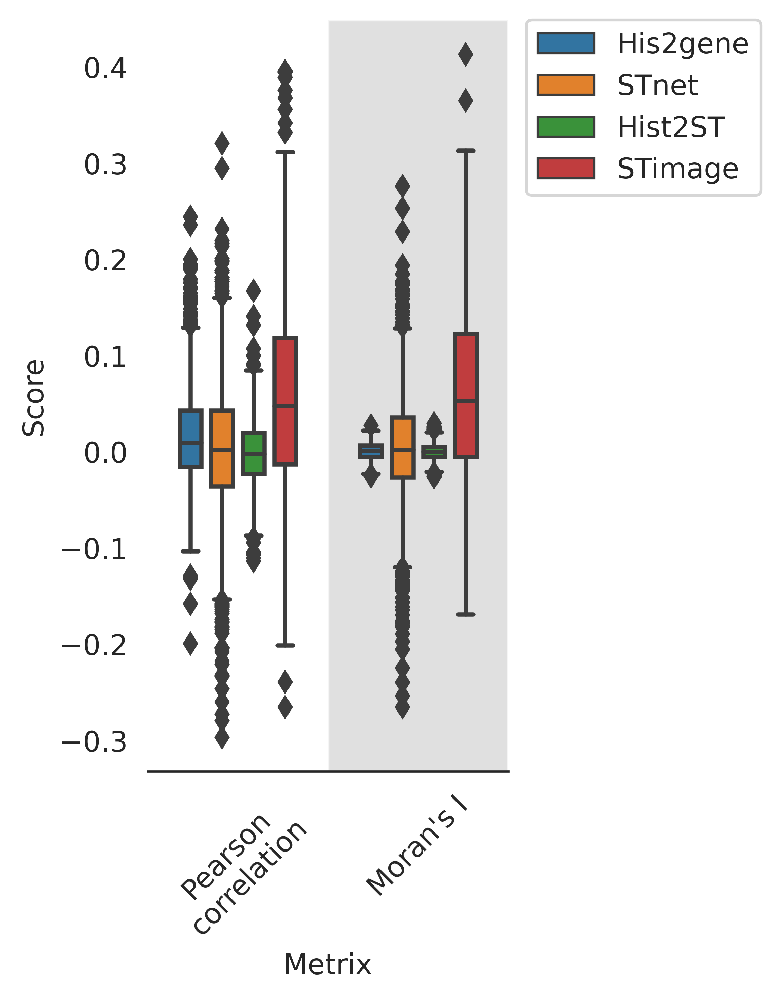

In [47]:
fig = plt.figure(figsize=(4, 5))
a = sns.boxplot(x="Metrix", y="Score", hue="Method",

               width=0.7,
               data=df_new_2)
a.set_xticklabels(a.get_xticklabels(), rotation=45)
sns.despine(left=True)
a.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
adjust_box_widths(fig, 0.7)
plt.autoscale()
gs = GridShader(a, facecolor="lightgrey", first=False, alpha=0.7)
plt.tight_layout()
plt.savefig("./benchmarking_OOD_FFPE_1000hvg.png", dpi=300)
plt.show()

/tmp/ipykernel_151106/134068136.py:141: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  image_pil.thumbnail(scale_size, Image.ANTIALIAS)
/tmp/ipykernel_151106/134068136.py:141: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  image_pil.thumbnail(scale_size, Image.ANTIALIAS)
/tmp/ipykernel_151106/134068136.py:141: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  image_pil.thumbnail(scale_size, Image.ANTIALIAS)
/tmp/ipykernel_151106/134068136.py:141: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  image_pil.thumbnail(scale_size, Image.ANTIALIAS)


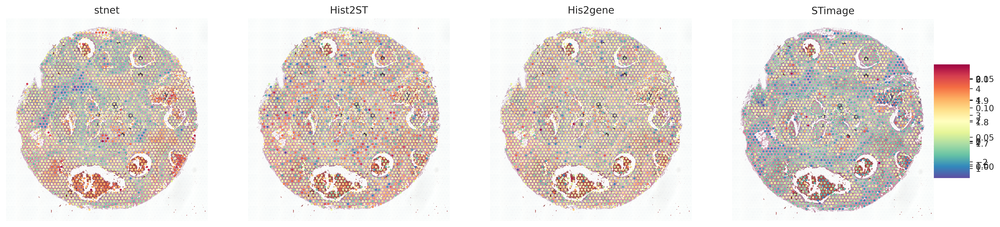

In [21]:
m_list = ["stnet", "Hist2ST", "His2gene", "STimage"]
fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(20, 5))
for i, adata in enumerate(pred_adata_list):
    gene_plot(adata, genes="S100A14", library_id="FFPE", fig=fig,ax=axes[i],
             image_scale=10)
    axes[i].title.set_text(m_list[i])
plt.show()